<a href="https://colab.research.google.com/github/ajithpious/Colab-Notebooks/blob/main/Freq_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Load Data

In [ ]:
import pickle
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
from bokeh.plotting import figure, show
import bokeh.io
bokeh.io.output_notebook()

In [ ]:
file = open('/content/drive/MyDrive/Works/Iceni/Data_Analysis/HFAnalysis/Data/Sample1/vse_vib_hf_04-10-2023_14-38-43.pickle','rb')
data = pickle.load(file)

In [ ]:
headers = data['headers']
name = data['name']
readings = data['data']
type = data['type']
sample_rate = 25000
sample_length = 10
sample_period = 1.0/sample_rate
print(sample_period)

4e-05


# Convert pickle to DataFrame

In [ ]:
np.array(readings[0])

array([[ 148,   78,   60, ..., -119,  -64,  -31],
       [  14,   65,   40, ..., -182, -224, -284],
       [ 415,  375,  301, ...,  408,  443,  481],
       [-284, -211, -211, ...,   91,   51,  -58]])

In [ ]:
acc_readings = np.array(readings[0]).T
acc_readings

array([[ 148,   14,  415, -284],
       [  78,   65,  375, -211],
       [  60,   40,  301, -211],
       ...,
       [-119, -182,  408,   91],
       [ -64, -224,  443,   51],
       [ -31, -284,  481,  -58]])

In [ ]:
# Calculating the time
num_of_samples = acc_readings.shape[0]
total_duration = (num_of_samples-1)*sample_period
time = np.linspace(0, total_duration, num_of_samples)
print(time.shape)

(250048,)


In [ ]:
len(time)

250048

In [ ]:
acc_time_readings = np.column_stack((acc_readings,time))
# acc_time_readings

In [ ]:
acc_df = pd.DataFrame(acc_time_readings,columns=headers[:-1]+['time'])
order = ['time']+acc_df.columns[:-1].tolist()
print(order)
acc_df = acc_df[order]

['time', 'vse_vib_gb_high_accel', 'vse_vib_gb_low_accel', 'vse_vib_shaft_accel', 'vse_vib_gen_accel']


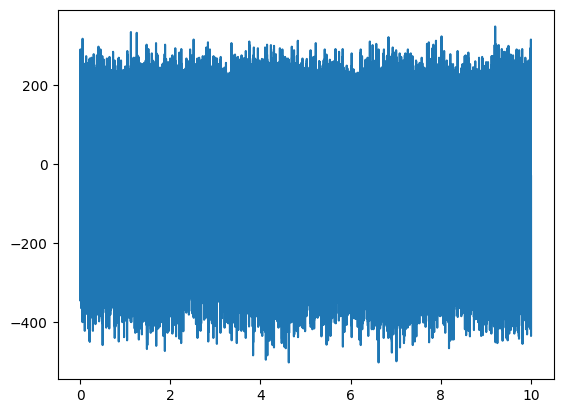

In [ ]:
plt.plot(acc_df['time'],acc_df['vse_vib_gb_high_accel'])

In [ ]:
px.line(x=acc_df['time'],y=acc_df['vse_vib_gb_high_accel'])

In [41]:
f = figure(height=600,width=1500)
f.line(acc_df['time'],acc_df['vse_vib_gb_high_accel'])
show(f)

#Save to CSV

In [ ]:
acc_df.to_csv('/content/drive/MyDrive/Works/Iceni/Data_Analysis/HFAnalysis/Data/Sample1/acc_readings.csv',index=False)

#FFT - acceleration

In [ ]:
from scipy.fft import fft, fftfreq
import matplotlib.pyplot as plt


In [ ]:
columns = list(acc_df.columns)
columns.pop(0)
columns

['vse_vib_gb_high_accel',
 'vse_vib_gb_low_accel',
 'vse_vib_shaft_accel',
 'vse_vib_gen_accel']

In [ ]:
fft_df = pd.DataFrame()

In [ ]:
for col in columns:
  fft_df[col] = abs(fft(acc_df[col].values))

In [ ]:
freq = fftfreq(num_of_samples,sample_period)
fft_df['freq'] = freq
cols = list(fft_df.columns)
order = ['freq']+cols[:-1]
fft_df= fft_df[order]
order

['freq',
 'vse_vib_gb_high_accel',
 'vse_vib_gb_low_accel',
 'vse_vib_shaft_accel',
 'vse_vib_gen_accel']

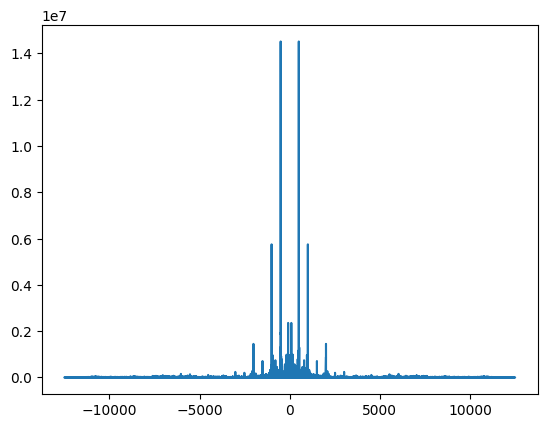

In [ ]:
plt.plot(fft_df['freq'],fft_df['vse_vib_gb_high_accel'])

In [ ]:
acc_fft_df=fft_df[fft_df['freq']>=0]

In [42]:
f=figure(height=600,width=1500)
f.line(acc_fft_df['freq'],acc_fft_df['vse_vib_gb_high_accel'])
# plt.plot(acc_fft_df['freq'],acc_fft_df['vse_vib_gb_high_accel'])
show(f)

#FFT - Velocity

##Convert Acceleration to Velocity

In [ ]:
from scipy.signal import butter, filtfilt
# filter params for butterworth filter
order = 4
cutoff_freq = 2
Fmax = 3000
print(cutoff_freq/(Fmax))
vel_df = pd.DataFrame()
cols = list(acc_df.columns)[1:]
vel_df['time'] = acc_df['time']
for col in cols:
  v_col = col.replace('_accel','_vel')
  # Using high pass butterworth filter to filter out the DC
  b,a = butter(order,cutoff_freq/(Fmax),btype='high',analog=False, output='ba')
  acc_fil = filtfilt(b, a, acc_df[col])
  # integrating
  vel_sig = np.cumsum(acc_fil)*sample_period
  # Filtering to remove the DC Shift in the signal
  b,a = butter(order,cutoff_freq/(Fmax),btype='high',analog=False, output='ba')
  vel_df[v_col] = filtfilt(b, a, vel_sig)


0.0006666666666666666


In [43]:
f=figure(height=600,width=1500)
f.line(vel_df['time'],vel_df['vse_vib_gb_high_vel'])
show(f)

In [ ]:
f=figure(height=600,width=1500)
f.line(acc_df['time'],acc_df['vse_vib_gb_high_accel'])
show(f)

##FFT of Velocity

In [ ]:
from scipy.fft import fft, fftfreq
import matplotlib.pyplot as plt


In [ ]:
columns = list(vel_df.columns)
columns.pop(0)
columns

['vse_vib_gb_high_vel',
 'vse_vib_gb_low_vel',
 'vse_vib_shaft_vel',
 'vse_vib_gen_vel']

In [ ]:
fft_df = pd.DataFrame()
for col in columns:
  fft_df[col] = abs(fft(vel_df[col].values))
freq = fftfreq(num_of_samples,sample_period)
fft_df['freq'] = freq
cols = list(fft_df.columns)
order = ['freq']+cols[:-1]
fft_df= fft_df[order]
order

['freq',
 'vse_vib_gb_high_vel',
 'vse_vib_gb_low_vel',
 'vse_vib_shaft_vel',
 'vse_vib_gen_vel']

In [ ]:
vel_fft_df=fft_df[fft_df['freq']>=0]

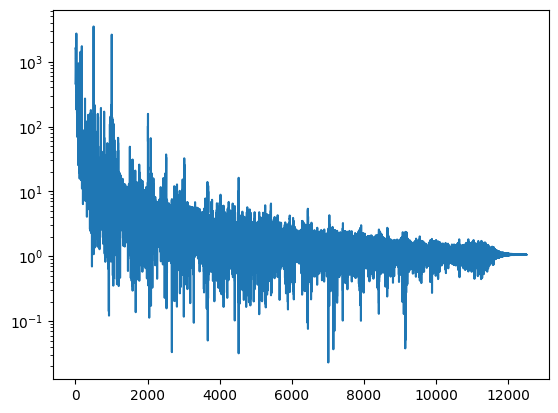

In [ ]:
plt.semilogy(vel_fft_df['freq'],vel_fft_df['vse_vib_gen_vel'])

In [45]:
from bokeh.models import LogAxis
f= figure(height=600,width=1500)
# f.yaxis[0].formatter = LogAxis()
# f.extra_y_ranges = {"log_y": LogAxis()}
# f.add_layout(LogAxis(y_range_name="log_y", axis_label="Y-Axis (log scale)"), 'right')

f.line(vel_fft_df['freq'],vel_fft_df['vse_vib_gen_vel'])

show(f)

#Envelope of Acceleration Signal

##Find the Envelop of Acceleration Signal

In [ ]:
acc_df

In [ ]:
from scipy.signal import butter, filtfilt, hilbert
# filter params for butterworth filter
order = 4
cutoff_freq = 2
Fmax = 12000
print(cutoff_freq/(Fmax))
env_df = pd.DataFrame()
cols = list(acc_df.columns)[1:]
env_df['time'] = acc_df['time']
for col in cols:
  env_col = col.replace('_accel','_env')
  # Using high pass butterworth filter to filter out the DC
  b,a = butter(order,(500.0/(Fmax),10000.0/Fmax),btype='band',analog=False, output='ba')
  fil_acc = filtfilt(b, a, acc_df[col])
  # finding the hilbert transform for envelope
  env_df[env_col] = np.abs(hilbert(fil_acc))

0.00016666666666666666


In [46]:
f = figure(height=600,width=1500)
f.line(env_df['time'],env_df['vse_vib_gb_high_env'])
show(f)

In [ ]:
f = figure(height=600,width=1500)
f.line(acc_df['time'],acc_df['vse_vib_gb_high_accel'])
show(f)

##FFT of Envelop Signal

In [ ]:
from scipy.fft import fft, fftfreq
import matplotlib.pyplot as plt


In [ ]:
columns = list(env_df.columns)
columns.pop(0)
columns

['vse_vib_gb_high_env',
 'vse_vib_gb_low_env',
 'vse_vib_shaft_env',
 'vse_vib_gen_env']

In [ ]:
fft_df = pd.DataFrame()
for col in columns:
  fft_df[col] = abs(fft(env_df[col].values))
freq = fftfreq(num_of_samples,sample_period)
fft_df['freq'] = freq
cols = list(fft_df.columns)
order = ['freq']+cols[:-1]
fft_df= fft_df[order]
env_fft_df=fft_df[fft_df['freq']>=0]

In [48]:
from bokeh.models import LogAxis
f= figure(height=600,width=1500)
# f.yaxis[0].formatter = LogAxis()
# f.extra_y_ranges = {"log_y": LogAxis()}
# f.add_layout(LogAxis(y_range_name="log_y", axis_label="Y-Axis (log scale)"), 'right')

f.line(env_fft_df['freq'],env_fft_df['vse_vib_gen_env'])

show(f)

In [52]:
from bokeh.document import Document
from bokeh.embed import file_html
from bokeh.models import (Circle, ColumnDataSource, CustomJS, LinearAxis,
                          PanTool, Plot, TapTool, WheelZoomTool)
from bokeh.util.browser import view

source = ColumnDataSource(
    data = dict(
        x = [1, 2, 3, 4, 4,   5, 5],
        y = [5, 4, 3, 2, 2.1, 1, 1.1],
        color = ["red", "green", "blue", "#2c7fb8", "grey", "#2c7fb8", "lightgrey"],
    ),
)

plot = Plot()
plot.title.text = "Click a circle execute a JavaScript callback"

circle = Circle(x="x", y="y", radius=0.2, fill_color="color", line_color="black")
circle_renderer = plot.add_glyph(source, circle)

plot.add_layout(LinearAxis(), 'below')
plot.add_layout(LinearAxis(), 'left')

customjs = CustomJS(args=dict(source=source), code="""
  const colors = source.selected.indices.map((i) => source.data["color"][i])
  window.alert("Selected colors: " + colors)
""")

tap = TapTool(renderers=[circle_renderer], callback=customjs)
plot.add_tools(PanTool(), WheelZoomTool(), tap)

doc = Document()
doc.add_root(plot)

if __name__ == "__main__":
    doc.validate()
    filename = "customjs.html"
    with open(filename, "w") as f:
        f.write(file_html(doc, title="Demonstration of custom callback written in TypeScript"))
    print(f"Wrote {filename}")
    view(filename)
show()

Wrote customjs.html


In [122]:
from __future__ import annotations

import numpy as np

from bokeh import events
from bokeh.io import curdoc, show
from bokeh.layouts import column, row
from bokeh.models import Button, CustomJS, Div, TextInput,Text
from bokeh.plotting import figure

def handleClearAll(x1_text:TextInput,x2_text:TextInput,y1_text:TextInput,y2_text:TextInput)->CustomJS:

  return CustomJS(args=dict(x1_text=x1_text,x2_text=x2_text,y1_text=y1_text,y2_text=y2_text), code=f"""
        x1_text.value = ""
        x2_text.value = ""

        y1_text.value = ""
        y2_text.value = ""
    """)





def display_event(div1: Div,div2:Div,x1_text:TextInput,x2_text:TextInput,y1_text:TextInput,y2_text:TextInput, attributes: list[str] = []) -> CustomJS:
    """
    Function to build a suitable CustomJS to display the current event
    in the div model.
    """
    style = 'float: left; clear: left; font-size: 13px'
    return CustomJS(args=dict(div1=div1,div2=div2,x1_text=x1_text,x2_text=x2_text,y1_text=y1_text,y2_text=y2_text), code=f"""
        const attrs = {attributes};
        const args = [];
        console.log('cb==',cb_obj)
        const whichOne = ()=>{{
          if(x1_text.value===""){{
            return 'first'
          }}
          else if(x1_text.value!="" && x2_text.value === ""){{
            return 'second'
          }}
          else if(x1_text.value!="" && x2_text.value!=""){{
            return 'clear'
          }}

        }}
        for (let i = 0; i < attrs.length; i++) {{
            const val = JSON.stringify(cb_obj[attrs[i]], function(key, val) {{
                return val.toFixed ? Number(val.toFixed(2)) : val;
            }})
            console.log('val===',val)
            args.push(attrs[i] + '=' + val)
        }}
        console.log('value====',x1_text.value)
        let one = whichOne()
        if(one == 'first'){{
          x1_text.value = cb_obj['x'].toString()
          y1_text.value = cb_obj['y'].toString()
        }}else if(one == 'second'){{
          x2_text.value = cb_obj['x'].toString()
          y2_text.value = cb_obj['y'].toString()
        }}else if(one == 'clear'){{
          x1_text.value = ""
          x2_text.value = ""
          y1_text.value = ""
          y2_text.value = ""
          x1_text.value = cb_obj['x'].toString()
          y1_text.value = cb_obj['y'].toString()

        }}
        let diff1 = Number(x2_text.value) - Number(x1_text.value)
        div1.text = "<span style={style!r}><b>" + diff1  + "</span>\\n";
        let diff2 =  Number(y2_text.value) - Number(y1_text.value)
        div2.text = "<span style={style!r}><b>" + diff2  + "</span>\\n";
        console.log(cb_obj.event_name)
        const line = "<span style={style!r}><b>" + cb_obj.event_name + "</b>(" + args.join(", ") + ")</span>\\n";
        const text = div.text.concat(line);
        const lines = text.split("\\n")
        if (lines.length > 35)
            lines.shift();
        div.text = line
    """)

# Follows the color_scatter gallery example

N = 4000
x = env_fft_df['freq']
y = env_fft_df['vse_vib_gen_env']
radii = np.random.random(size=N) * 1.5
colors = np.array([(r, g, 150) for r, g in zip(50+2*x, 30+2*y)], dtype="uint8")

p = figure(tools="pan,wheel_zoom,zoom_in,zoom_out,reset,tap,lasso_select,box_select,box_zoom,undo,redo",width=1500)

p.line(env_fft_df['freq'],env_fft_df['vse_vib_gen_env'])
# p.scatter(x, y, radius=radii,
#           fill_color=colors, fill_alpha=0.6,
#           line_color=None)

# Add a div to display events and a button to trigger button click events

div1 = Div(width=300)
div2 = Div(width=500)
button = Button(label="Clear All", button_type="success", width=300)
# heading = Text('')
x1_text = TextInput(placeholder="X1", width=300)
x2_text = TextInput(placeholder="X2", width=300)
y1_text = TextInput(placeholder="Y1", width=300)
y2_text = TextInput(placeholder="Y2", width=300)
layout = column(button, row(x1_text,y1_text),row(x2_text,y2_text),row(div1,div2),row(p))

# Register event callbacks

# Button events
button.js_on_event(events.ButtonClick, handleClearAll(x1_text,x2_text,y1_text,y2_text))

# TextInput events
# text_input.js_on_event(events.ValueSubmit, display_event(div,text_input, ["value"]))

# LOD events
# p.js_on_event(events.LODStart, display_event(div))
# p.js_on_event(events.LODEnd, display_event(div))

# Point events
point_attributes = ['x','y','sx','sy']
p.js_on_event(events.Tap,       display_event(div1,div2,x1_text,x2_text,y1_text,y2_text, attributes=point_attributes))
# p.js_on_event(events.DoubleTap, display_event(div, attributes=point_attributes))
# p.js_on_event(events.Press,     display_event(div, attributes=point_attributes))
# p.js_on_event(events.PressUp,   display_event(div, attributes=point_attributes))

# Mouse wheel event
# p.js_on_event(events.MouseWheel, display_event(div,attributes=[*point_attributes, 'delta']))

# Mouse move, enter and leave
# p.js_on_event(events.MouseMove,  display_event(div, attributes=point_attributes))
# p.js_on_event(events.MouseEnter, display_event(div, attributes=point_attributes))
# p.js_on_event(events.MouseLeave, display_event(div, attributes=point_attributes))

# Pan events
pan_attributes = [*point_attributes, 'delta_x', 'delta_y']
# p.js_on_event(events.Pan,      display_event(div, attributes=pan_attributes))
# p.js_on_event(events.PanStart, display_event(div, attributes=point_attributes))
# p.js_on_event(events.PanEnd,   display_event(div, attributes=point_attributes))

# Pinch events
# pinch_attributes = [*point_attributes, 'scale']
# p.js_on_event(events.Pinch,      display_event(div, attributes=pinch_attributes))
# p.js_on_event(events.PinchStart, display_event(div, attributes=point_attributes))
# p.js_on_event(events.PinchEnd,   display_event(div, attributes=point_attributes))

# Ranges Update events
# p.js_on_event(events.RangesUpdate, display_event(div, attributes=['x0','x1','y0','y1']))

# Selection events
# p.js_on_event(events.SelectionGeometry, display_event(div, attributes=['geometry', 'final']))

curdoc().on_event(events.DocumentReady, display_event(div1,div2,x1_text,x2_text,y1_text,y2_text))

show(layout)

In [75]:
from bokeh.plotting import figure, show, ColumnDataSource
from bokeh.models import TapTool, CustomJS

# Sample data (you can replace this with your own data)
x = [1, 2, 3, 4, 5]
y = [10, 11, 8, 15, 12]

# Create a Bokeh figure
p = figure(title="Select and Highlight Points", width=800, height=400)

# Create a data source
source = ColumnDataSource(data=dict(x=x, y=y, color=["blue"] * len(x)))

# Plot the data
scatter = p.circle('x', 'y', size=10, source=source, color='color')

# Define a callback for the TapTool
callback = CustomJS(args=dict(source=source), code="""
    const selected = source.selected.indices;
    const data = source.data;
    const color = data.color;

    // Copy the current colors to avoid overwriting other points
    const newColors = [...color];

    // Highlight the selected points in red
    for (let i = 0; i < selected.length; i++) {
        newColors[selected[i]] = (newColors[selected[i]]=="red")?"blue":"red";
    }

    // Update the colors
    color.splice(0, color.length, ...newColors);

    // Trigger a change in the data source
    source.change.emit();
""")

# Add the TapTool with the callback
p.add_tools(TapTool(callback=callback))

# Show the plot
show(p)


In [77]:
from bokeh.plotting import figure, show
from bokeh.models import ColumnDataSource, TapTool, CustomJS

# Sample data (you can replace this with your own data)
x = [1, 2, 3, 4, 5]
y = [10, 11, 8, 15, 12]

# Create a Bokeh figure
p = figure(title="Select and Highlight Nearest Point", width=800, height=400)

# Create a data source
source = ColumnDataSource(data=dict(x=x, y=y, color=["blue"] * len(x)))

# Plot the data
scatter = p.circle('x', 'y', size=10, source=source, color='color')

# Define a callback for the TapTool
callback = CustomJS(args=dict(source=source), code="""
    const selected = source.selected.indices;
    const data = source.data;
    const color = data.color;

    // Get the coordinates of the selected point
    const selectedX = data.x[selected[0]];
    const selectedY = data.y[selected[0]];

    // Find the nearest point based on Euclidean distance
    let minDistance = Infinity;
    let nearestIndex = -1;

    for (let i = 0; i < data.x.length; i++) {
        if (i !== selected[0]) {  // Skip the selected point
            const distance = Math.sqrt(Math.pow(data.x[i] - selectedX, 2) + Math.pow(data.y[i] - selectedY, 2));
            if (distance < minDistance) {
                minDistance = distance;
                nearestIndex = i;
            }
        }
    }

    // Highlight the nearest point in red
    color[nearestIndex] = "red";

    // Trigger a change in the data source
    source.change.emit();
""")

# Add the TapTool with the callback
p.add_tools(TapTool(callback=callback))

# Show the plot
show(p)
